## Sentiment Analysis on Amazon Fine Food Reviews:

### Introduction:
In this project, I produced a sentiment analysis covering over 500,000 reviews from an Amazon Fine Food Review dataset. I classified all positive and negative customer reviews and then created word clouds, plotly visualizations, and a text classification model to display my analysis further.

### Data : 
For this project, I used the Amazon Fine Food Review [dataset](https://www.kaggle.com/snap/amazon-fine-food-reviews?select=Reviews.csv) found on Kaggle.

In [2]:
# The code was removed by Watson Studio for sharing.

/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: 

All imports installed...!


In [ ]:
print("All imports installed...!")

In [3]:
# The code was removed by Watson Studio for sharing.

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [16]:
amazon = df_data_2

amazon.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


### Methodology: 

To prepare for this analysis, I visualized the product scores from the dataset in a histogram using the plotly library.

In [5]:
# Visualizing Product Scores - Histogram

fig = px.histogram(amazon, x="Score")
fig.update_layout(title_text = "Product Score")
fig.show()

From the blue histogram, we can see more positive customer ratings than negative. Therefore, the majority of Amazon’s product reviews are positive.

#### Methodology: 

Next, I created a word cloud to show the most frequently used words in the text (review) column. Before starting, I checked for any null values and used natural language processing such as NLTK stopwords before generating my word cloud.

In [4]:
amazon.isna().sum()

Id                         0
ProductId                  0
UserId                     0
ProfileName               16
HelpfulnessNumerator       0
HelpfulnessDenominator     0
Score                      0
Time                       0
Summary                   27
Text                       0
dtype: int64

The above code shows that column 'Text' doesn't have any null values.

### Review Word Cloud 

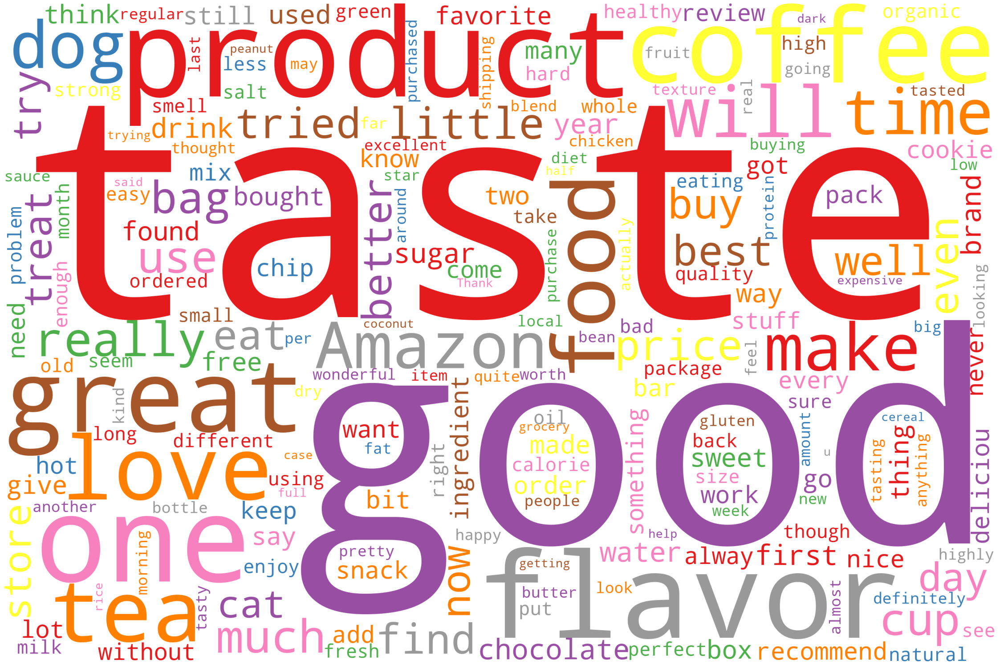

In [5]:
text = " ".join(review for review in amazon.Text)

# Removing errors in Text column
stopwords = set(STOPWORDS)
stopwords.update(["br", "href"])

wordcloud = WordCloud(width = 3000, height = 2000, random_state = 1, stopwords=stopwords, background_color = "white", colormap = 'Set1', collocations = False).generate(text)

plot_cloud(wordcloud)

#### Methodology: 

Next, I added a sentiment column by classifying only positive and negative reviews using the dataset's 'Score' column. For this sentiment, I categorized all positive reviews as scores > 3, negative for scores < 3, and dropped all neutral scores, which  = 3. Note, the sentiment column will later be used as training data for the sentiment classification model. 

In [6]:
amazon = amazon[amazon.Score != 3]

# Postive = 1 
# Negative = -1

amazon ["Sentiment"] = amazon["Score"].apply(lambda x: -1 if x < 3 else +1)

amazon.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1


In [7]:
amazon.dtypes

Id                         int64
ProductId                 object
UserId                    object
ProfileName               object
HelpfulnessNumerator       int64
HelpfulnessDenominator     int64
Score                      int64
Time                       int64
Summary                   object
Text                      object
Sentiment                  int64
dtype: object

#### Methodology: 

After building the sentiment column, I also created word clouds to display the most frequently used words for both positive and negative product reviews, respectfully. In addition, I made a product sentiment histogram to show the distribution of reviews with sentiment across the dataset.

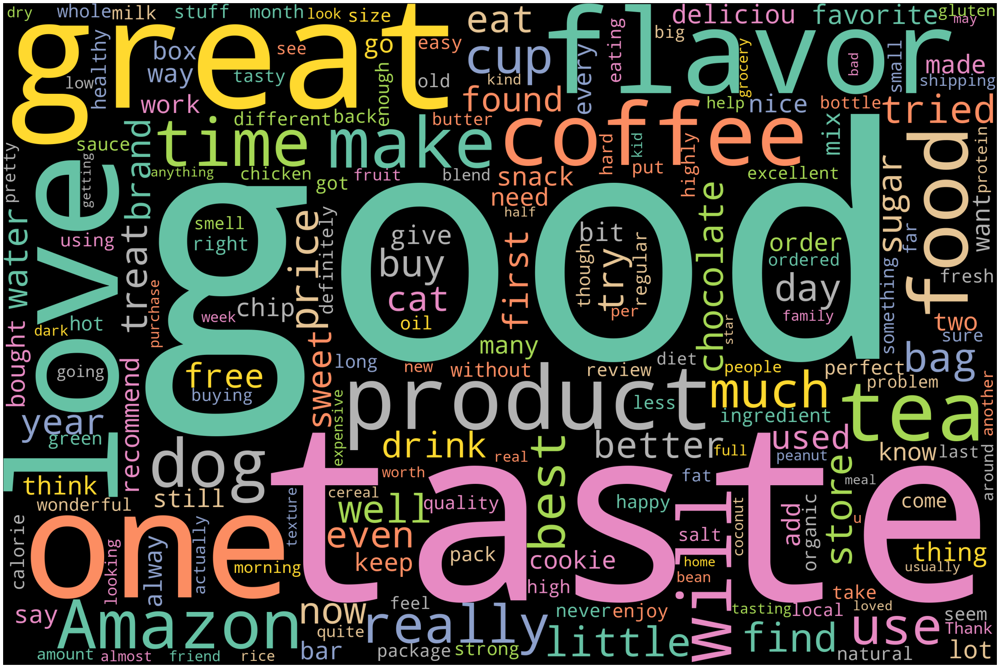

In [8]:
# Postive Word Cloud

positive = amazon[amazon["Sentiment"] == 1]

text = " ".join(review for review in positive.Text)

text = text.replace('\n', "")

stopwords = set(STOPWORDS)
stopwords.update(["br", "href"])

wordcloud.postive = WordCloud(width = 3000, height = 2000, random_state = 1, stopwords=stopwords, background_color = "black", colormap = 'Set2', collocations = False).generate(text)

plot_cloud(wordcloud.postive)

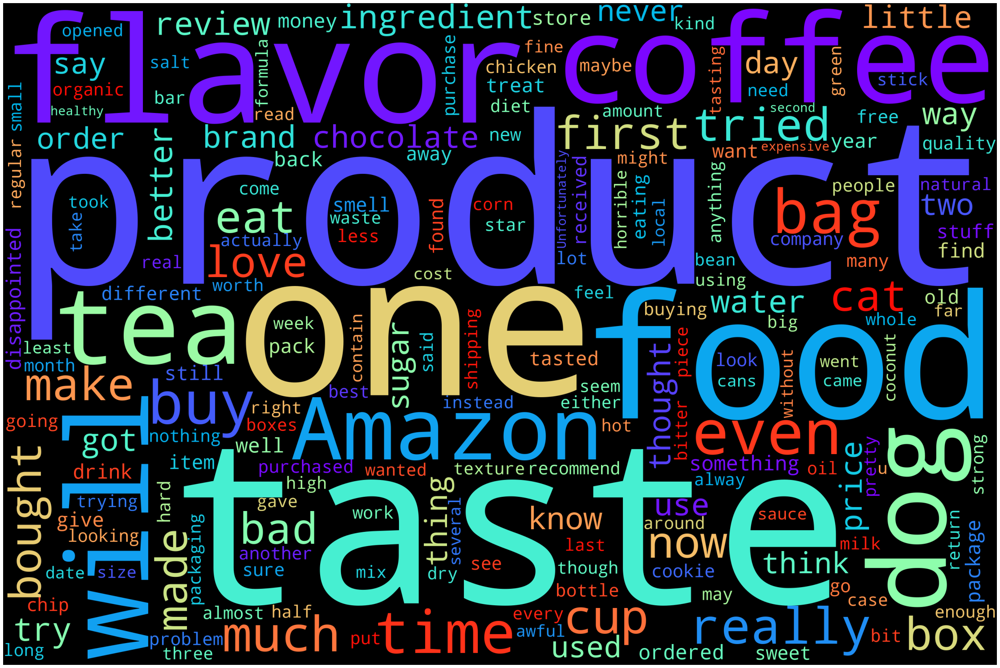

In [9]:
# Negative Word Cloud

negative = amazon[amazon["Sentiment"] == -1]

text = " ".join(review for review in negative.Text)

text = text.replace('\n', "")

stopwords = set(STOPWORDS)
stopwords.update(["good", "great", "br", "href"])

wordcloud.negative = WordCloud(width = 3000, height = 2000, random_state = 1, stopwords=stopwords, background_color = "black", colormap = 'rainbow', collocations = False).generate(text)

plot_cloud(wordcloud.negative)

## Product Sentiment Histogram

In [7]:
amazon ["Sentiment_Rate"] = amazon["Sentiment"].apply(lambda x: "Negative" if x == -1 else "Positive")

fig = px.histogram(amazon, x = "Sentiment_Rate")

fig.update_traces(marker_color = 'orange', marker_line_width=1.5)

fig.update_layout(title_text = "Product Sentiment")

fig.show()

From the orange histogram, we can see that the product sentiment is more positive than negative. 

#### Methodology: 

Finally, I created a text classification model to train and establish the accuracy of my data. I start by pre-processing the textual data using NLTK to remove special characters, lowercasing text, and stopwords. Then, I test the accuracy of the sentiment model by performing the Multi Nominal Naive Bayes Classification function using the scikit-learn library. 

In [11]:
amazon.Summary = amazon['Summary'].str.replace('[^\w\s]','')

amazon.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Sentiment,Sentiment_Rate
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1,Positive
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1,Negative
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,Delight says it all,This is a confection that has been around a fe...,1,Positive
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1,Negative
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1,Positive


In [12]:
sentiment_df = amazon[["Summary", "Sentiment"]]

sentiment_df.head()

,Summary,Sentiment
0,Good Quality Dog Food,1
1,Not as Advertised,-1
2,Delight says it all,1
3,Cough Medicine,-1
4,Great taffy,1


Data Pre-Processing

In [13]:
df = sentiment_df

df["Summary"] = df["Summary"].astype(str)

# Change to lowercasing for all text reviews in 'Summary'

df["Summary"] = df["Summary"].apply(lambda x: " ".join(x.lower() for x in x.split()))

df["Summary"][2]


'delight says it all'

In [14]:
stop = set(stopwords)

df["Summary"] = df["Summary"].apply(lambda x: " ".join(x for x in x.split() if x not in stop ))

df["Summary"][2]



'delight says'

In [15]:
cv = CountVectorizer(token_pattern=r'\b\w+\b')
text_counts = cv.fit_transform(df["Summary"])

X_train, X_test, y_train, y_test = train_test_split(
    text_counts, df["Sentiment"], test_size=0.3, random_state=1)

# Multinomial Naive Bayes Model
clf = MultinomialNB().fit(X_train, y_train)
predicted= clf.predict(X_test)


print("Multinomial Naive Bayes Accuracy:",metrics.accuracy_score(y_test, predicted))

Multinomial Naive Bayes Accuracy: 0.9048654473992837


As a result, the overall classification rate has an approx. 90.5% accuracy!